# INM430 - The Rise of Short-term Rentals: An Exploratory Case Study of Airbnb in London 

***

**Student Name:** Philip Adzanoukpe

***

## Importing Libraries

In [99]:
# some builtin imports
import re
import warnings
from collections import Counter
import time
from datetime import datetime
warnings.filterwarnings('ignore')

# Some usual imports here
import csv 
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl
from mpl_toolkits.axes_grid1 import make_axes_locatable

# import stats modules
import scipy.stats as stats
import statsmodels.api as sm
import statsmodels.stats.api as sms

# sklearn models
from sklearn.preprocessing import StandardScaler

# import geo libs
import geopandas as gpd
import folium as fm
from folium.plugins import HeatMap, MarkerCluster
from shapely.geometry import Point, Polygon
import contextily as ctx
from geopy.distance import great_circle

## Customize Matplotlib Parameters
%matplotlib inline
mpl.rcParams['figure.dpi']= 300
mpl.rcParams['figure.edgecolor']= 'black'
mpl.rcParams['axes.linewidth']= .5
# Customize Seaborn Parameters
sns.set()
rc = {
      'font.family': ['serif'], 
      'font.serif':'Times New Roman',
      'grid.color': 'gainsboro',
      'grid.linestyle': '-', 
}
sns.set_style(rc=rc)
sns.set_context("notebook", font_scale=0.8)

# define constant variables
LONDON_CENTROID = (51.510444, -0.115639)

## Loading data

### Airbnb London data

In [100]:
# load airbnb data retrieved from http://insideairbnb.com/get-the-data.html
df = pd.read_csv("data/airbnb_listings_london_full.csv")
df.head()

,id,listing_url,scrape_id,last_scraped,name,summary,space,description,experiences_offered,neighborhood_overview,...,instant_bookable,is_business_travel_ready,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,11551,https://www.airbnb.com/rooms/11551,20190914144451,2019-09-15,Arty and Bright London Apartment in Zone 2,Unlike most rental apartments out there my fla...,"Amenities Bedding: 1 Double bed, 1 living room...",Unlike most rental apartments out there my fla...,family,Not even 10 minutes by metro from Victoria Sta...,...,t,f,strict_14_with_grace_period,f,t,2,2,0,0,1.59
1,13913,https://www.airbnb.com/rooms/13913,20190914144451,2019-09-15,Holiday London DB Room Let-on going,My bright double bedroom with a large window h...,"Hello Everyone, I'm offering my lovely double ...",My bright double bedroom with a large window h...,business,Finsbury Park is a friendly melting pot commun...,...,f,f,moderate,f,f,3,1,2,0,0.14
2,15400,https://www.airbnb.com/rooms/15400,20190914144451,2019-09-15,Bright Chelsea Apartment. Chelsea!,Lots of windows and light. St Luke's Gardens ...,Bright Chelsea Apartment This is a bright one...,Lots of windows and light. St Luke's Gardens ...,romantic,It is Chelsea.,...,t,f,strict_14_with_grace_period,t,t,1,1,0,0,0.73
3,17402,https://www.airbnb.com/rooms/17402,20190914144451,2019-09-15,Superb 3-Bed/2 Bath & Wifi: Trendy W1,You'll have a wonderful stay in this superb mo...,"This is a wonderful very popular beautiful, sp...",You'll have a wonderful stay in this superb mo...,none,"Location, location, location! You won't find b...",...,t,f,strict_14_with_grace_period,f,f,15,15,0,0,0.40
4,24328,https://www.airbnb.com/rooms/24328,20190914144451,2019-09-15,Battersea bedroom & office w parking shared ga...,"Artist house, bright high ceiling rooms, priva...",- End of terrace two bedroom house close to So...,"Artist house, bright high ceiling rooms, priva...",family,"- Battersea is a quiet family area, easy acces...",...,f,f,moderate,t,t,1,1,0,0,0.86


### Boundary shapefile

In [101]:
# load london bounday shapefile into geodataframe
geo_df = gpd.read_file("assets/statistical-gis-boundaries-london/ESRI/London_Borough_Excluding_MHW.shp")
geo_df.head()

,NAME,GSS_CODE,HECTARES,NONLD_AREA,ONS_INNER,SUB_2009,SUB_2006,geometry
0,Kingston upon Thames,E09000021,3726.117,0.000,F,None,None,"POLYGON ((516401.600 160201.800, 516407.300 16..."
1,Croydon,E09000008,8649.441,0.000,F,None,None,"POLYGON ((535009.200 159504.700, 535005.500 15..."
2,Bromley,E09000006,15013.487,0.000,F,None,None,"POLYGON ((540373.600 157530.400, 540361.200 15..."
3,Hounslow,E09000018,5658.541,60.755,F,None,None,"POLYGON ((521975.800 178100.000, 521967.700 17..."
4,Ealing,E09000009,5554.428,0.000,F,None,None,"POLYGON ((510253.500 182881.600, 510249.900 18..."


# Preprocessing data

## Cleaning columns

In [102]:
# For Airbnb listings, we first need to drop some useless comments such as id, listing_url and scrape_id  are not relevant due to the data type 
# and some others we will not use such as id
# columns for airbnb listings
selected_columns = [
    'availability_365', 'bathrooms', 'bedrooms', 'amenities', 'summary',
    'cancellation_policy', 'experiences_offered', 'host_is_superhost', 'beds', 'bed_type',
    'latitude', 'longitude', 'number_of_reviews', 'reviews_per_month', 'instant_bookable',
    'room_type', 'minimum_nights', 'space', 'description', 'calculated_host_listings_count',
    'accommodates', 'cleaning_fee', 'neighbourhood_cleansed', 'price',
]
df.drop(columns=[c for c in df.columns if c not in selected_columns], inplace=True)
# Using cancellation policy from airbnb website to group policies into Flexible, Moderate, and Strict
# https://www.airbnb.co.uk/home/cancellation_policies
df.replace({
    'cancellation_policy': {
        'strict_14_with_grace_period': 'strict',
        'super_strict_30': 'strict',
        'super_strict_60': 'strict',
        'luxury_super_strict_95': 'strict',
        'luxury_moderate': 'moderate'
    }
}, inplace=True)

# drop unused columns in bounday shapefile
geo_df.drop(columns=['GSS_CODE', 'HECTARES', 'NONLD_AREA', 'ONS_INNER', 'SUB_2009', 'SUB_2006'], inplace=True)

In [103]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 85273 entries, 0 to 85272
Data columns (total 24 columns):
summary                           81043 non-null object
space                             59101 non-null object
description                       83021 non-null object
experiences_offered               85273 non-null object
host_is_superhost                 85257 non-null object
neighbourhood_cleansed            85273 non-null object
latitude                          85273 non-null float64
longitude                         85273 non-null float64
room_type                         85273 non-null object
accommodates                      85273 non-null int64
bathrooms                         85146 non-null float64
bedrooms                          85231 non-null float64
beds                              85120 non-null float64
bed_type                          85273 non-null object
amenities                         85273 non-null object
price                             85273 non-nul

In [104]:
# select NAME and geometry, rename NAME to borough
geo_df.rename(columns={'NAME': 'borough'}, inplace=True)
geo_df.head()

,borough,geometry
0,Kingston upon Thames,"POLYGON ((516401.600 160201.800, 516407.300 16..."
1,Croydon,"POLYGON ((535009.200 159504.700, 535005.500 15..."
2,Bromley,"POLYGON ((540373.600 157530.400, 540361.200 15..."
3,Hounslow,"POLYGON ((521975.800 178100.000, 521967.700 17..."
4,Ealing,"POLYGON ((510253.500 182881.600, 510249.900 18..."


## Imputing Missing Values

In [105]:
# first we check for missing values in the dataset by defining a function to compute missing data.
def compute_missing_data(df):
    """Function to compute missing data count and percentage and output a table"""
    mising_sum = df.isnull().sum()
    total = mising_sum.sort_values(ascending=False)

    percent = (mising_sum*100)/df.isnull().count().sort_values(ascending=False)
    missing_data = pd.concat([total, percent], axis=1, keys=['Total','Percent'], 
                             sort=False).sort_values('Total', ascending=False)
    return missing_data

# print table containing missing data
compute_missing_data(df)

,Total,Percent
space,26172,30.692013
cleaning_fee,21529,25.247147
reviews_per_month,21003,24.630305
summary,4230,4.960539
description,2252,2.640930
beds,153,0.179424
bathrooms,127,0.148933
bedrooms,42,0.049254
host_is_superhost,16,0.018763
availability_365,0,0.000000


In [106]:
# define a function to cleanup price column
def clean_price(val):
    """A function to remove dollar sign in prices, convert it to float type and 
    finally convert it to pounds"""
    if not isinstance(val, (float, int)):
        val = float(val.replace('$', '').replace(',', ''))
    pound_to_dollar_rate = 0.76
    return val*pound_to_dollar_rate

In [107]:
# first convert columns to appropriate types
# convert price and cleaning_fee to numeric
df.loc[:, 'price'] = df.loc[:, 'price'].apply(clean_price)
df.loc[:, 'cleaning_fee'] = df.loc[:, 'cleaning_fee'].apply(clean_price)
# rename neighbourhood_cleansed column
df.rename(columns={'neighbourhood_cleansed': 'borough'}, inplace=True)
## Transform Categorical Columns into pandas.category type
cat_cols = ['experiences_offered', 'host_is_superhost', 'room_type', 'cancellation_policy', 'instant_bookable', 'borough', 'bed_type']
df[cat_cols] = df[cat_cols].apply(lambda x: x.astype('category'))

# filling missing values
# Textual attributes such as description, summary and space are going to be imputed by an empty string. 
# The reviews_per_month refers to number of reviews per month, it was probably not scraped properly or that listings have no reviews at all; hence it'll be replaced with 0
# bathrooms and bedrooms being a fixed numeric, will be replaced using the mean, and cleaning_fee being numeric, 
# the median applies as a central tendency measure since the distribution is skewed.
# host_is_superhost being a categorical indicating super host or not will be replaced by 'f'
df = df.fillna(value={
    'reviews_per_month':0,
    'beds': np.floor(df.beds.mean()),
    'cleaning_fee': df.cleaning_fee.median(),
    'bathrooms': np.floor(df.bathrooms.mean()),
    'bedrooms': np.floor(df.bedrooms.mean()),
    'host_is_superhost': 'f',
    'summary': '',
    'space': '',
    'description': ''
})

In [108]:
# We should have a dataset with no missing values now :)
compute_missing_data(df)

,Total,Percent
reviews_per_month,0,0.0
calculated_host_listings_count,0,0.0
cancellation_policy,0,0.0
instant_bookable,0,0.0
number_of_reviews,0,0.0
availability_365,0,0.0
minimum_nights,0,0.0
cleaning_fee,0,0.0
price,0,0.0
amenities,0,0.0


## Feature Engineering

We can broadly categorize them into two groups : the first containing new features that are useful combinations of existing attributes, and the second one being normalized versions of existing attributes.
First group of features:


- $amenities\_count$ : count of words in amenities attribute.

- $summary\_count$ : count of words in amenities attribute.

- $space\_count$ : count of words in space attribute.

- $description\_count$ : count of words in description attribute.

- $distance\_to\_center$ : Distance of accomodation to central London in km

- $Occupancy\ Rate = \frac{number\ of\ reviews}{review\ rate} * average\ length\ of\ stay$. Represent an estimate on how often an Airbnb listing is being rented out, and also approximate a listing's income.
    - A Review Rate of 50\% is used to convert reviews to estimated bookings
    - An average length of stay configured for each London (4.6), and this, multiplied by the estimated bookings gives the occupancy rate
 

- $Annual\ Income = Occupancy\ rate * price * months\ in\ a\ year$. Represent an approximate annual earnings per host.

Second group of features :

- $popularity\_index = \frac{number\ of\ reviews}{total\ number\ of\ reviews} * 100$ : Represents the proportion of reviews from the total reviews in the dataset.

### Amenities count

In [109]:
df.amenities.head()

0    {TV,"Cable TV",Internet,Wifi,Kitchen,"Paid par...
1    {TV,"Cable TV",Wifi,Kitchen,"Paid parking off ...
2    {TV,"Cable TV",Internet,Wifi,"Air conditioning...
3    {TV,Wifi,Kitchen,"Paid parking off premises",E...
4    {TV,"Cable TV",Internet,Wifi,Kitchen,"Free par...
Name: amenities, dtype: object

In [110]:
def clean_amenities(value):
    """A function to remove unwanted characters and convert it to list of words"""
    return value.strip('{}')\
             .replace('"', '')\
             .lstrip('\"')\
             .rstrip('\"')\
             .split(',')

In [111]:
# create a column amenities_count by spliting amenities text by comma and count the total words present in each row
df['amenities'] = df['amenities'].apply(clean_amenities)
df['amenities_count'] = df['amenities'].apply(np.count_nonzero)

### Property description count

In [112]:
df.summary.head()

0    Unlike most rental apartments out there my fla...
1    My bright double bedroom with a large window h...
2    Lots of windows and light.  St Luke's Gardens ...
3    You'll have a wonderful stay in this superb mo...
4    Artist house, bright high ceiling rooms, priva...
Name: summary, dtype: object

In [113]:
# I used regular expressions to find all strings in case of punctuation marks or special characters in the string
# Finally count the number of words
description_cols = ['summary', 'space', 'description']
for col in description_cols:
    df[f'{col}_count'] = df[col].apply(lambda x: len(re.findall(r'\w+', x)))

# drop description columns since we only need the count for the scope of the analysis
df.drop(columns=description_cols, inplace=True)

### Distance to center of London

In [114]:
# We'll use latitude and longitude values of each accommodation to calculate the distance to central London using 
# the *Great-circle distance* algorithm implemented by `geopy.distance.great_circle` function.
def distance_to_mid(lat, lon):
    """Function to calculate distance between 2 geographical coordinates"""
    return great_circle(LONDON_CENTROID, (lat, lon)).km

In [115]:
df['distance_to_center'] = df.apply(lambda x: distance_to_mid(x.latitude, x.longitude), axis=1)

### Popularity Index

In [116]:
# Popularity index shows listings popularity based on the number of reviews per 
# listings divided by the total number of reviews in all listings
# calculate total total_reviews
total_reviews = float(df.number_of_reviews.sum())
# calculate popularity index
df['popularity_index'] = (df['number_of_reviews'] / total_reviews) * 100
# drop number_of_reviews columns since it's been transformed
df.drop(columns=['number_of_reviews'], inplace=True)

### Occupancy rate

In [117]:
def calculate_occupancy_rate(row, review_rate):
    """Calculate occupancy rate of a listing
    Occupancy Rate = Booked Nights * average length of stay in London
    """
    # Here we assume a guest may leave a review after their stay, so we'll use number_of_reviews and 
    # estimated number of average length of stay in London (4.6 night per stay).
    lenth_of_stay = 4.6
    booked_nights = row['reviews_per_month'] / review_rate
    return round(booked_nights * lenth_of_stay, 2)

In [118]:
# With a very modest review rate of 50%, we are assuming that only every second guest left a review.
# using of 50% as modest review rate
modest_review_rate = 0.5
df['modest_occupancy'] = df.apply(lambda x: calculate_occupancy_rate(x, modest_review_rate), axis=1)

# occupancy cannot be greater than 100% - probably mistakes during scrapping of the data?
print('Number of occupancy greater than 100%:', len(df[df['modest_occupancy'] > 100]))
# let's drop modest_occupancy rates > 100
df.drop(df[(df['modest_occupancy'] > 100)].index, axis=0, inplace=True)

Number of occupancy greater than 100%: 28


In [119]:
# Now let's try for a more optimistic estimate of occupancy using a review rate of 0.3, which assumes that only 30% of all guests left a review.
# using average 30% as optimistic review rate
optimistic_review_rate = 0.3
df['optimistic_occupancy'] = df.apply(lambda x: calculate_occupancy_rate(x, optimistic_review_rate), axis=1)

# occupancy cannot be greater than 100% - probably mistakes during scrapping of the data?
print('Number of occupancy greater than 100%:', len(df[df['optimistic_occupancy'] > 100]))
# let's drop optimistic_occupancy rates > 100
df.drop(df[(df['optimistic_occupancy'] > 100)].index, axis=0, inplace=True)

Number of occupancy greater than 100%: 590


In [120]:
# reposition price column to the end of the table
price = df.price
df.drop(columns=['price'], inplace=True)
df['price'] = price

### Estimated annual income

Using our modest and optimistic estimates for the occupancy rate, we'll now do the same for income

In [121]:
# income = price * occupancy rate * months in year
df['modest_income'] = df.price * df.modest_occupancy * 12
df['optimistic_income'] = df.price * df.optimistic_occupancy * 12

In [122]:
df.head()

,experiences_offered,host_is_superhost,borough,latitude,longitude,room_type,accommodates,bathrooms,bedrooms,beds,...,summary_count,space_count,description_count,distance_to_center,popularity_index,modest_occupancy,optimistic_occupancy,price,modest_income,optimistic_income
0,family,t,Lambeth,51.46225,-0.11732,Entire home/apt,4,1.0,1.0,1.0,...,88,57,172,5.360200,0.012831,14.63,24.38,66.88,11741.4528,19566.4128
1,business,f,Islington,51.56802,-0.11121,Private room,2,1.0,1.0,0.0,...,52,114,185,6.409492,0.001116,1.29,2.15,49.40,764.7120,1274.5200
2,romantic,t,Kensington and Chelsea,51.48796,-0.16898,Entire home/apt,2,1.0,1.0,1.0,...,46,168,177,4.459155,0.006067,6.72,11.19,76.00,6128.6400,10205.2800
3,none,t,Westminster,51.52098,-0.14002,Entire home/apt,6,2.0,3.0,4.0,...,52,156,161,2.053969,0.002859,3.68,6.13,228.00,10068.4800,16771.6800
4,family,f,Wandsworth,51.47298,-0.16376,Entire home/apt,2,1.5,1.0,1.0,...,79,82,170,5.334167,0.006485,7.91,13.19,133.00,12624.3600,21051.2400


In [65]:
# saving final dataset, maybe used later
df.to_csv("data/processed_airbnb.csv", index=False)

# Exploratory data analysis

Exploring the data by analyzing its statistics and visualizing the values of features and correlations between different features. Explaining the process and the results.

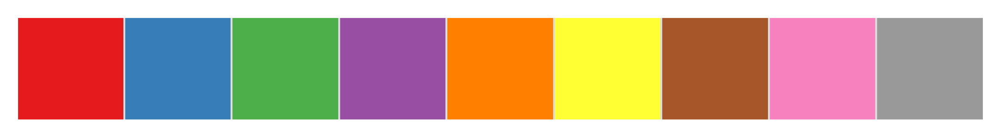

In [66]:
### choose set2 as the default color
color_set = sns.color_palette("Set1")

## Set Seaborn Color Palette
sns.set_palette(color_set)

## Visualize Color Palette
sns.palplot(color_set)

## Reusable plotting functions

In [67]:
# define a reusable function to plot heatmap and choropleth maps
def plot_choropleth_map(df, variable, title=None, cmap='YlOrRd', basemap=True, 
                        map_bg=ctx.providers.Stamen.TonerLite, ax=None, legend_label=None, plot_kwds={}):
    """
    Function to plot choropleth map given a geodataframe and column name
    """
    df = df.to_crs(epsg=3857)
    # create figure and axes for Matplotlib
    if not ax:
        fig, ax = plt.subplots(figsize=(10, 10))
    # create divider
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("bottom", size="5%", pad=0.1)
    legend_kwds = {'orientation': 'horizontal', 'label': legend_label}
    # create map
    df.plot(
        column=variable, cmap=cmap, linewidth=0.5, 
        edgecolor='0.5', ax=ax, alpha=0.6, cax=cax,
        legend=True, legend_kwds=legend_kwds, **plot_kwds
    )
    
    # remove the axis
    _ = ax.set_axis_off()
    
    if title: # add a title
        _ = ax.set_title(title)
    
    if basemap:
        # add base map
        ctx.add_basemap(ax, url=map_bg)
    
    return ax

def plot_folium_heatmap(lat, lon, weights=[]):
    # Visualize the listings using longitude and latitude columns
    xmm=(lat.min()+lat.max())/2
    ymm=(lon.min()+lon.max())/2
    
    if len(weights) <= 0:
        data = [[lt, ln] for lt, ln in zip(lat, lon)]
    else:
        data = [[lt, ln, wt] for lt, ln, wt in zip(lat, lon, weights)]

    hmap = fm.Map(location=[xmm, ymm], zoom_start = 11, control_scale=False)
    # create heat a map using latitude and longitude
    HeatMap(data, radius=7, blur=6, min_opacity=0.2,
            gradient={0.2:'blue',0.4:'purple',0.6:'orange',1.0:'red'}
           ).add_to(hmap)
    # display heatmap
    return hmap

# lollipop chart is really useful if you have 2 observations for each groups.
# Instead of displaying the values of both groups one beside each other, show them on the same line and represent only their difference!
def plot_lollipop(x1_col, x2_col, y_col, about, df, ax=None, show=False):
    """
    Function that creates a lollipop chart with 
    two observations (x-values) per group (y-value).
    https://python-graph-gallery.com/184-lollipop-plot-with-2-groups/
    """
    
    # prepare data
    df_plot = df[[y_col, x1_col, x2_col]].groupby(y_col).apply(lambda x: x.mean()).sort_values(x1_col).reset_index()
        
    # draw plot
    y_range = range(1, len(df_plot.index)+1)
    if not ax:
        fig, ax = plt.subplots(figsize=(12,8))
        
    ax.hlines (y=y_range, xmin=df_plot[x1_col], xmax=df_plot[x2_col], color='grey', alpha=0.4)
    ax.scatter(y=y_range, x=df_plot[x1_col], s=75, color='skyblue', alpha=1, label=x1_col)
    ax.scatter(y=y_range, x=df_plot[x2_col], s=75, color='green', alpha=0.4, label=x2_col)
    ax.legend()
    
    # title, label, ticks and xlim
    ax.set_title(f'Comparison of {about} by Borough', fontdict={'size':10, 'weight':'bold'})
    
    # Add title and axis names
    ax.set_yticks(y_range)
    ax.set_yticklabels(df_plot[y_col])
    ax.set(xlabel=about, ylabel=y_col)

    if show:
        plt.show()

## Measures of central tendency

Here, we perform the computation of central tendencies of all numeric attributes to output mean, standard deviation and quantiles of these attributes.

In [68]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
latitude,84655.0,51.509729,0.046354,51.294790,51.485460,51.514060,51.537570,5.168169e+01
longitude,84655.0,-0.127810,0.092287,-0.509160,-0.187980,-0.125920,-0.069870,2.877400e-01
accommodates,84655.0,3.208552,2.026996,1.000000,2.000000,2.000000,4.000000,3.000000e+01
bathrooms,84655.0,1.306296,0.615819,0.000000,1.000000,1.000000,1.500000,1.700000e+01
bedrooms,84655.0,1.420200,0.923930,0.000000,1.000000,1.000000,2.000000,2.200000e+01
cleaning_fee,84655.0,24.966680,34.069703,0.000000,1.000000,15.200000,38.000000,1.586120e+03
minimum_nights,84655.0,4.141646,15.707442,1.000000,1.000000,2.000000,3.000000,1.125000e+03
availability_365,84655.0,118.537476,134.800029,0.000000,0.000000,60.000000,252.000000,3.650000e+02
calculated_host_listings_count,84655.0,25.071337,131.558459,1.000000,1.000000,1.000000,5.000000,1.130000e+03
reviews_per_month,84655.0,0.836340,1.133994,0.000000,0.020000,0.370000,1.170000,6.520000e+00


## Rental Price

One of the first things we'll look at is the price distribution of accommodations in London. This is very important for guests as well hosts so they can understand the range of prices to expect in each neighbourhood.

In [69]:
# investigate price column
df.price.describe()

count    84655.000000
mean        98.943669
std        338.843138
min          0.000000
25%         34.960000
50%         63.840000
75%        106.400000
max      15200.000000
Name: price, dtype: float64

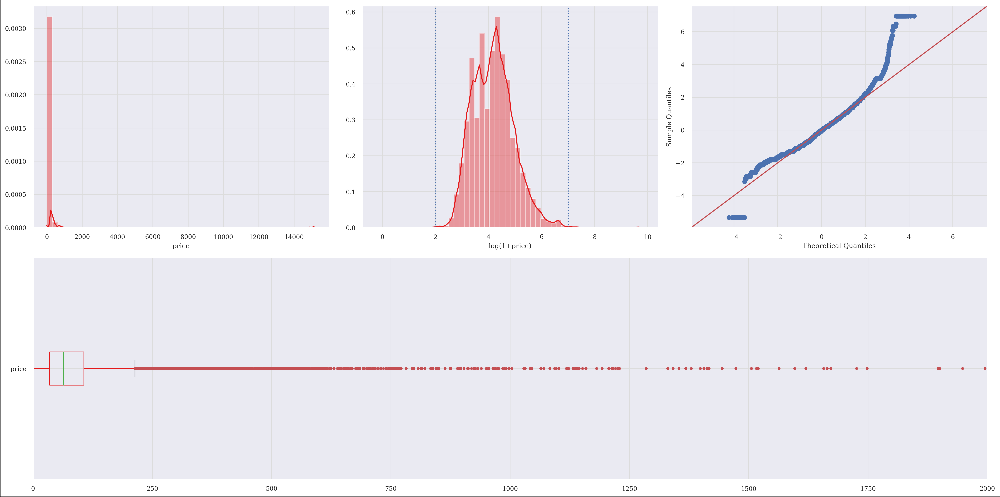

In [70]:
plt.figure(num=1, figsize=(20,10), linewidth=1)
# plot distribution of price
plt.subplot2grid((2, 3), (0, 0))
sns.distplot(df['price'])
# plot distribution of log(1+price)
plt.subplot2grid((2, 3), (0, 1))
sns.distplot(np.log1p(df['price']))
plt.axvline(x=2, color='b', linestyle=':')
plt.axvline(x=7, color='b', linestyle=':')
plt.xlabel('log(1+price)')
## plot qqplot of distribution of log(1+price)
ax = plt.subplot2grid((2, 3), (0, 2))
sm.qqplot(np.log1p(df['price']), stats.norm, fit=True, line='45', ax=ax);

# boxplot of price column
plt.subplot2grid((2, 3), (1, 0), colspan=3)
red = dict(markerfacecolor='r', markeredgecolor='r', marker='.')
df.price.plot(kind='box', xlim=(0, 2000), vert=False, flierprops=red)

plt.tight_layout();

In [71]:
# inverse of log transformed prices
outliers = df[(np.log1p(df['price']) < 2) | (np.log1p(df['price']) > 7)]
print(f'Number of listings which are assumed as outliers: {len(outliers)}\n')
print(f'Outlier price range: {np.exp(2) - 1} and {np.exp(7) - 1}')

Number of listings which are assumed as outliers: 238

Outlier price range: 6.38905609893065 and 1095.6331584284585


The plots above show quite a skewed distribution with a long tail of high-priced outliers. 
However, 75% of all rentals only cost up to £106. We can observe after log transformation, although it's not a perfect bell curve, we assume the prices show a normal distribution.

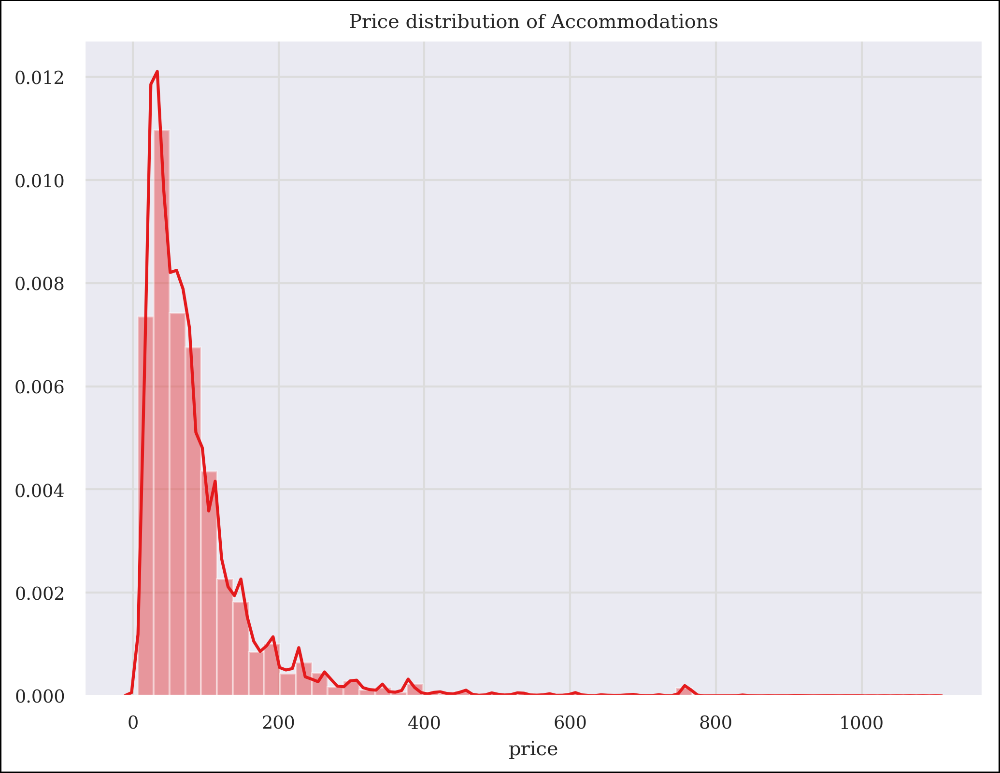

In [72]:
# plot price distribution of prices
plt.figure(num=1, figsize=(8,6), linewidth=1)
outlier_filter = df.index.isin(outliers.index)
sns.distplot(df.loc[~outlier_filter].price)
_= plt.title('Price distribution of Accommodations')

The distribution of prices is multimodal and right-tailed with most of the prices around the mean (£88). 
The red line above shows a probability "Density" function, which helps identify the regions in the regions the distribution where prices are more likely to occur, i.e. it is denser. The dominant peak is around £38. The second and third peaks are around £76 and £30 respectively.

## Spatial Analysis and Platform Activities

In this section, we aim to uncover some spatial distribution of listings and identify the neighbourhood that is rapidly being threatened by Airbnb-induced gentrification. It will be mainly about Univariate and Bivariate Analysis.

### Where are Airbnb listings located?

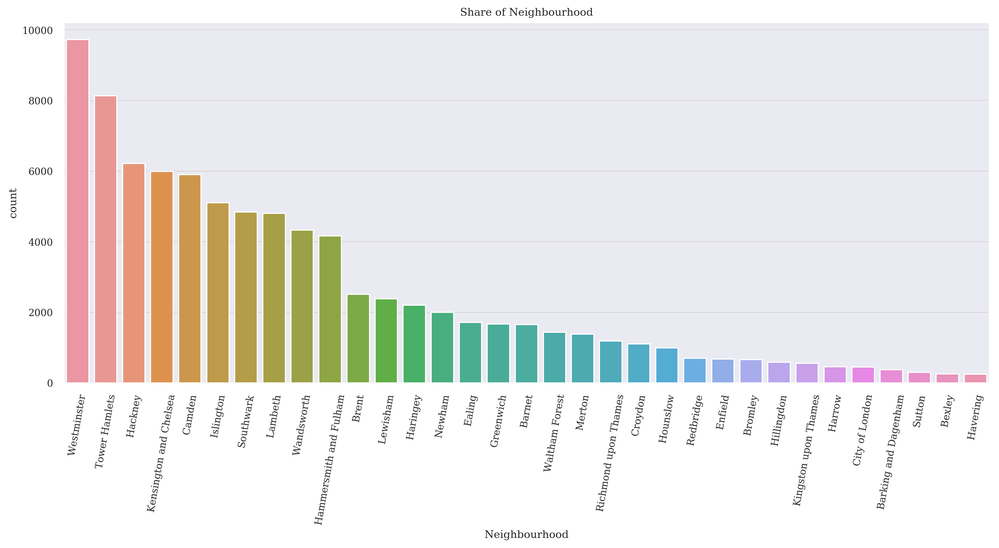

In [73]:
### Distribution of Listings in Borough
plt.figure(num=1, figsize=(15,6))
fig_1 = sns.countplot('borough',data=df, order=df['borough'].value_counts().index)
_ = fig_1.set_title("Share of Neighbourhood")
_ = plt.xticks(rotation=80)
_ = plt.xlabel("Neighbourhood")

**Comment**:

Interesting, we can see that there is a good distribution among the top 10 locations with the most listings. 
*Westminster* and *Tower hamlets* seem to have more than 8000+ listings. Hackney, Kensington and Chelsea, and Camden have almost the same number of listings of about 6000. Suton, Bexley and Havering have the least number of listings on Airbnb.

Let's go-ahead to visualize this on the map to uncover the locations of these areas.

### Density map of active Airbnb listings in London

In [74]:
# plot heatmap of neighbourhood listings
hmap = plot_folium_heatmap(df.latitude, df.longitude)
fm.CircleMarker(location=LONDON_CENTROID, radius=10, color='darkblue',).add_to(hmap)
display(hmap)

**Comment**

Density map of active Airbnb listings in the London region (2019), with important London neighbourhoods, indicated. The highest density areas are marked in red and lowest density areas are marked in blue colour.

### Price differences by accommodation distance to center of London

<Figure size 3600x1800 with 0 Axes>

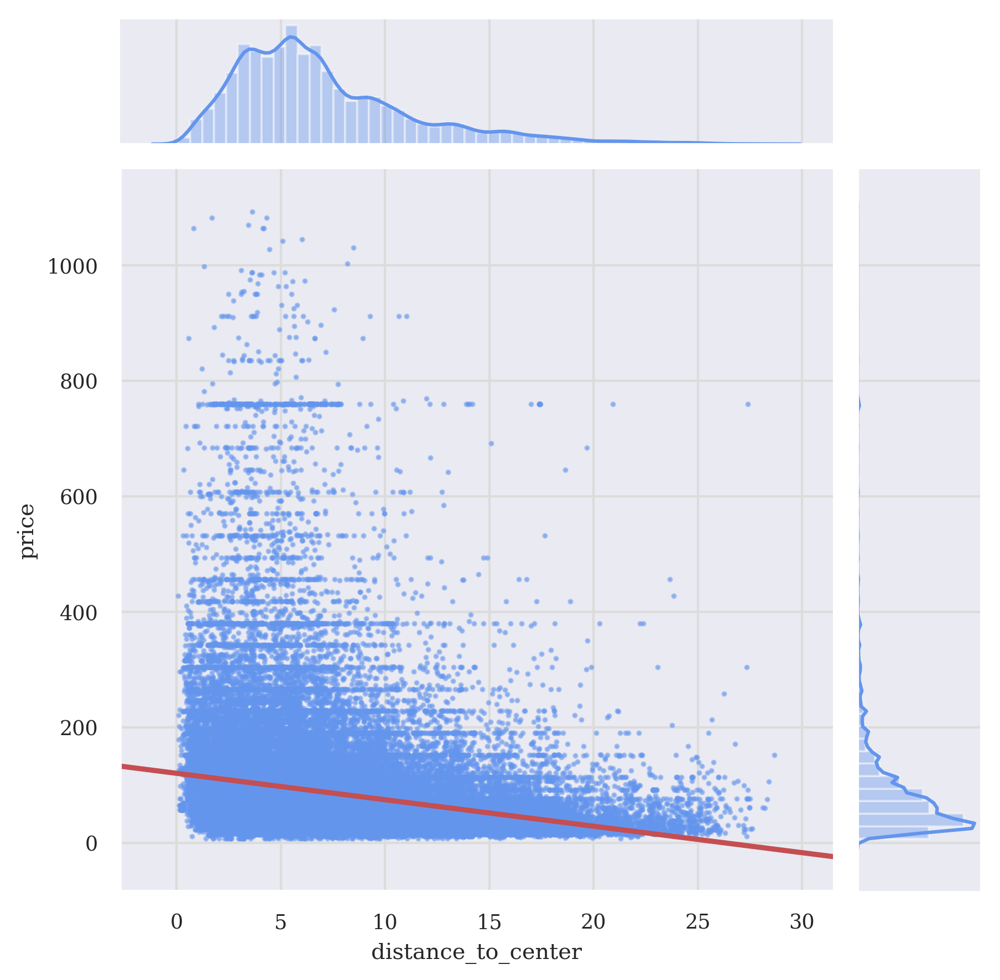

In [75]:
plt.figure(num=2, figsize=(12,6))
fig = sns.jointplot(x="distance_to_center", y="price", data=df[~outlier_filter], color='cornflowerblue', 
                    kind='reg', scatter_kws=dict(s=2, alpha=0.5), line_kws=dict(color='r')
                   )

**Comment**

The regression plot above shows that highly-priced accommodation is located in the city centre. This distribution and density of prices were completely expected as central is an expensive place to live as well it's proximity to the business centre and areas of interest for tourist.

### Lets check how price varies within the top 10 neighbourhood

In [76]:
# Now let find out the price distribution of the top 10 Boroughs
borough_table = []
# create a subset using the outlier filter
sub1 = df[~outlier_filter]
top_10_boroughs = sub1['borough'].value_counts().index[:10]
for b in top_10_boroughs:
    borough_table.append(sub1[sub1['borough'] == b]['price'].describe().T)

# print table
pd.DataFrame(borough_table, index=sub1['borough'].value_counts().index[:10]).sort_values(by='mean')

,count,mean,std,min,25%,50%,75%,max
Tower Hamlets,8120.0,68.883049,59.976334,7.60,30.40,55.48,85.12,838.28
Hackney,6206.0,69.181676,61.869605,6.84,32.68,57.00,83.60,950.00
Lambeth,4793.0,71.505963,64.506597,10.64,34.20,53.20,87.40,760.00
Southwark,4828.0,76.713248,75.800839,7.60,35.53,60.04,91.20,991.80
Islington,5093.0,85.607367,77.109745,6.84,41.80,68.40,98.80,984.20
Wandsworth,4325.0,86.267292,76.120042,7.60,38.00,64.60,110.20,896.80
Hammersmith and Fulham,4154.0,94.829119,89.116142,11.40,44.84,72.20,113.24,1003.20
Camden,5884.0,104.760265,91.336852,7.60,49.40,79.80,128.44,1083.00
Westminster,9659.0,143.912165,127.463634,7.60,68.40,105.64,174.04,1092.88
Kensington and Chelsea,5940.0,151.620512,136.954731,7.60,75.24,113.24,174.80,1070.08


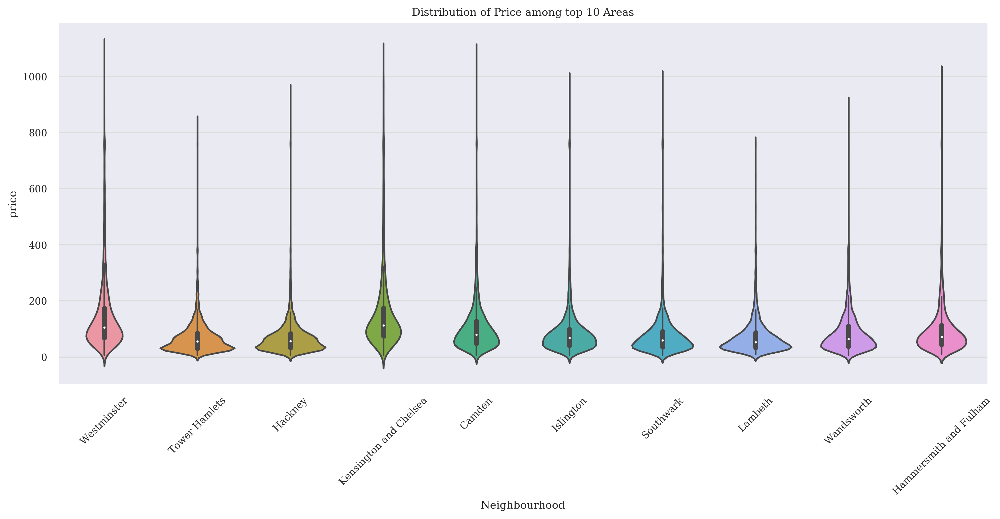

In [77]:
# Let's visualize the above table using violin plots
plt.figure(num=2, figsize=(15,6))
fig_2 = sns.violinplot(x='borough', y='price', data=sub1, order=top_10_boroughs)
_ = fig_2.set_title("Distribution of Price among top 10 Areas")
_ = fig_2.set_xlabel("Neighbourhood")
_ = plt.xticks(rotation=45)

**Comment**: 

Great, with the above violin plot we can definitely observe a couple of things about the distribution of prices for Airbnb in London. 
First, we can state that *Kensington and Chelsea* has the highest range of rent prices with an average of £151, followed by *Westminster* of average price £143 per night. 

*Camden, Wandsworth and Hammersmith and Fulham appear* to have very similar distributions, *Tower Hamlets* is the cheapest of them all.

### Room type in each top 10 neighbourhood

As we saw earlier, there are far too many neighbourhood values to concentrate on, so let's just grab the top 10 neighbourhoods with the most listings in them and unveil the room types in those areas.

<Figure size 6300x1800 with 0 Axes>

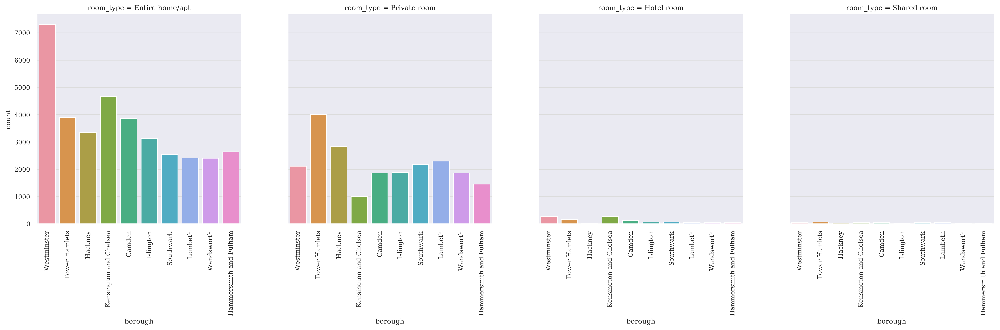

In [78]:
# create a subset of the data containing top 10 neighbourhood by listings count
sub_2 = df[df.borough.isin(top_10_boroughs)]

plt.figure(num=3, figsize=(21, 6))
#using catplot to represent multiple interesting attributes together and a count
col_order = sub_2.room_type.value_counts().index
fig3 = sns.catplot(x='borough', col='room_type', data=sub_2, kind='count', 
                order=top_10_boroughs, col_order=col_order)
_ = fig3.set_xticklabels(rotation=90)

**Comment:**

The most contrasted finding is that the Airbnb listing of 'shared space' type is scarcely accessible among ten most communities in the country. Then we can see that only Entire Home and Private Space are mostly accessible in those areas for these ten neighbourhoods: Westminster and Chelsea have the most vital records for Entire Home / Apartment than the others.

### Amenities Provided by Host

In [79]:
# create a counter to count amentities in the dataset
results = Counter()
df.amenities.apply(results.update)
# create a new sub dataframe with 'amenity' and 'count'
amenity_df = pd.DataFrame(results.most_common(20), columns=['amenity', 'count'])
amenity_df.head()

,amenity,count
0,Wifi,81363
1,Heating,79426
2,Essentials,78892
3,Kitchen,77551
4,Smoke detector,72352


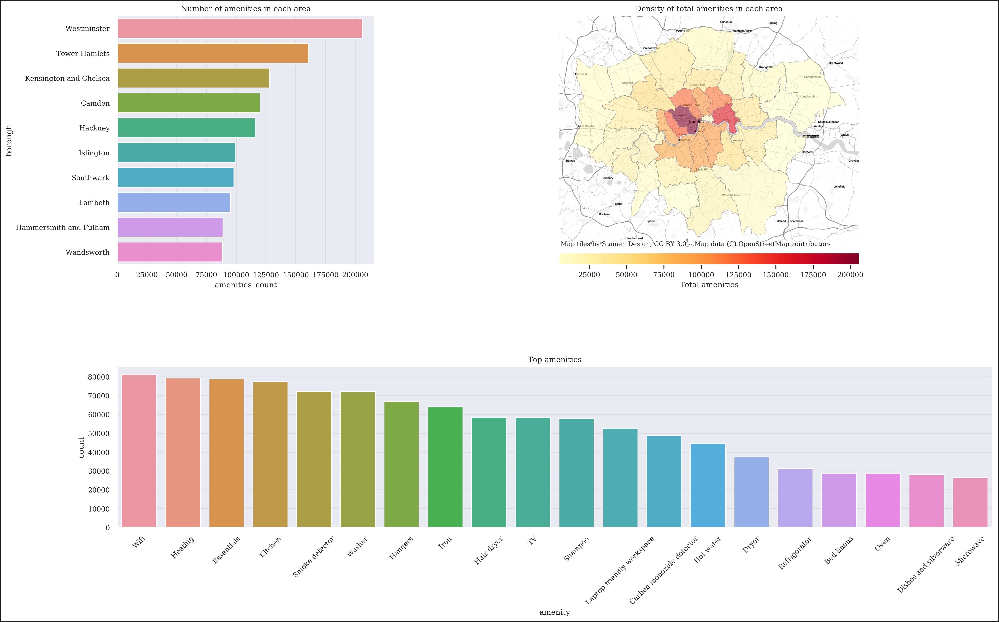

In [80]:
# group by neighbourhood and by status, then take the median income
g1 = df.groupby(['borough'])['amenities_count'].sum().reset_index()

# add geometry attribute 
g1_map = geo_df.merge(g1, on='borough').sort_values(ascending=False, by='amenities_count')
# create subplot figure
fig, ax = plt.subplots(figsize=(20, 12), linewidth=1)
# plot amentity count
ax1 = plt.subplot2grid((6, 3), (0, 0), rowspan=3, fig=fig)
sns.barplot(x='amenities_count', y='borough', data=g1_map, ax=ax1, order=g1_map.borough.values[:10])
_ = ax1.set_title("Number of amenities in each area")

# plot choropleth map to show total amenities in each neighbourhood
ax2 = plt.subplot2grid((6, 3), (0, 1), rowspan=3, colspan=2, fig=fig)
_ = plot_choropleth_map(
    g1_map, 'amenities_count', 'Density of total amenities in each area', 
    basemap=True, ax=ax2, legend_label="Total amenities"
)

# plot top amentities
ax3 = plt.subplot2grid((6, 3), (4, 0), colspan=3, rowspan=2,fig=fig)
sns.barplot(y='count', x='amenity', data=amenity_df, ax=ax3)
_ = ax3.set_title("Top amenities")
plt.sca(ax3)
_= plt.xticks(rotation=45)

**Comment:**

An interesting observation in Tower and Hamlets, although it as the lowest price distribution it is among the top areas with a considerable number of amenities provided. However, Westminster looks to stay on top with the highest number of amenities followed by Chelsea and Camden and Hackney.

### Availability in Neighbourhood

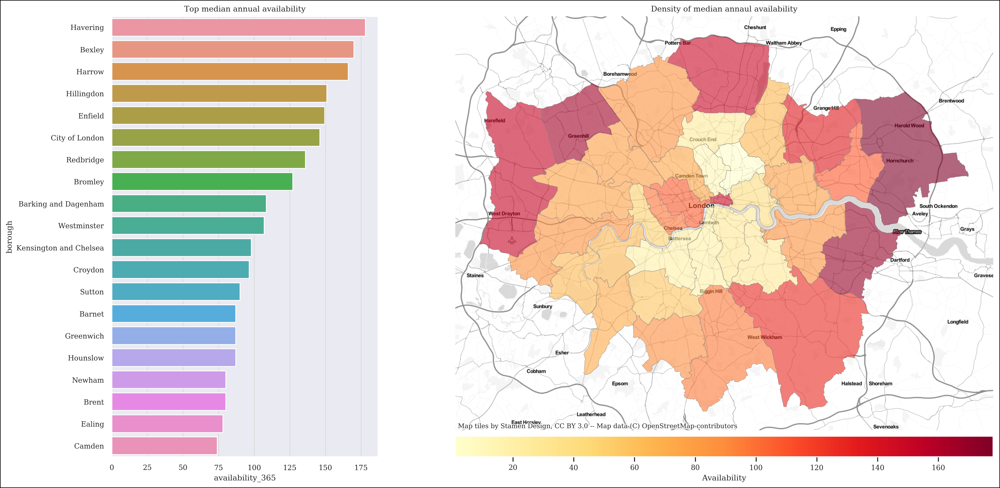

In [81]:
# Using spatial visualization, we'll uncover areas which have availability of listings. 
# This could give us insight on which areas that are rapidly being threathened by Airbnb-induced gentrification.
# group by neighbourhood and by status, then take the median income
g2 = df.groupby(['borough'])['availability_365'].median().reset_index()

# add geometry attribute 
g2_map = geo_df.merge(g2, on='borough').sort_values(ascending=False, by='availability_365')

fig, ax = plt.subplots(figsize=(20, 10), linewidth=1)
# plot average occupancy estimate by Boroughs
ax1 = plt.subplot2grid((2, 3), (0, 0), rowspan=2, fig=fig)
sns.barplot(x='availability_365', y='borough', data=g2_map, ax=ax1, order=g2_map.borough.values[:20])
_ = ax1.set_title("Top median annual availability")

# plot choropleth map to show availability
ax2 = plt.subplot2grid((2, 3), (0, 1), rowspan=2, colspan=2, fig=fig)
_ = plot_choropleth_map(
    g2_map, 'availability_365', 'Density of median annaul availability', 
    ax=ax2, legend_label="Availability"
)

**Comment**

The map shows an interesting observation, with most of the available houses away from the city centre. 

### Demand by Neighbourhood

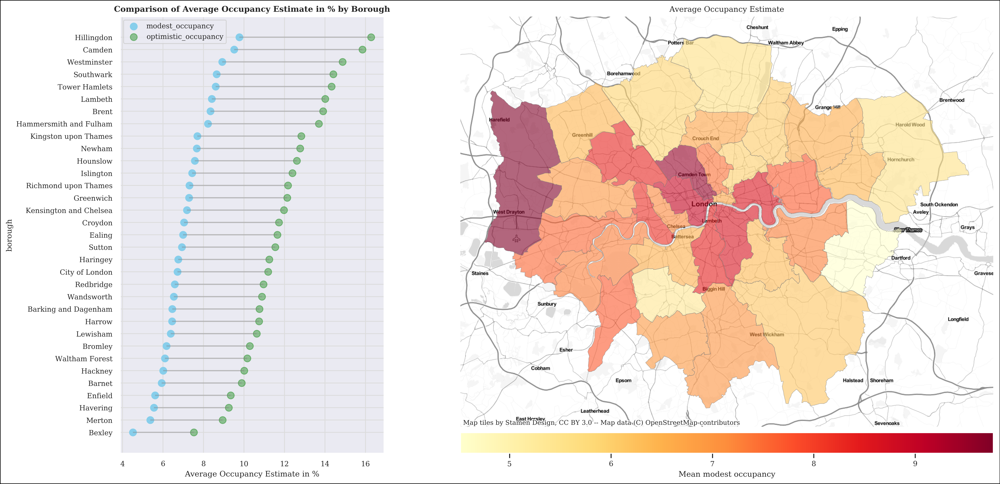

In [82]:
# group by neighbourhood and by status, then take the median income
# Using the occupancy rate in each area, we can visualize and understand short-term rental demands in each neighbourhood. 
# We will make use of the lollipop chart to observe the difference between modest and optimistic occupancy in each location. 
# Also, we will visualize the modest occupancy on the map. The higher density areas are marked with red, indicating higher occupancy in the location. 

g3 = df.groupby(['borough'])['modest_occupancy'].mean().reset_index()

fig, ax = plt.subplots(figsize=(20, 10), linewidth=1)
# plot average occupancy estimate by Boroughs
ax1 = plt.subplot2grid((2, 3), (0, 0), rowspan=2, fig=fig)

plot_lollipop('modest_occupancy', 'optimistic_occupancy', 'borough',
              'Average Occupancy Estimate in %', df, ax=ax1, show=False)

# add geometry attribute 
g3_map = geo_df.merge(g3, on='borough').sort_values(ascending=False, by='modest_occupancy')

# plot choropleth map to show availability
ax2 = plt.subplot2grid((2, 3), (0, 1), rowspan=2, colspan=2, fig=fig)
_ = plot_choropleth_map(
    g3_map, 'modest_occupancy', 'Average Occupancy Estimate', 
    basemap=True, ax=ax2, legend_label="Mean modest occupancy"
)

**Comment**

At the topmost is Hillingdon, which is not surprising since Heathrow airport is near the south end of London borough of Hillingdon.

### Neighbhourhood income estimates

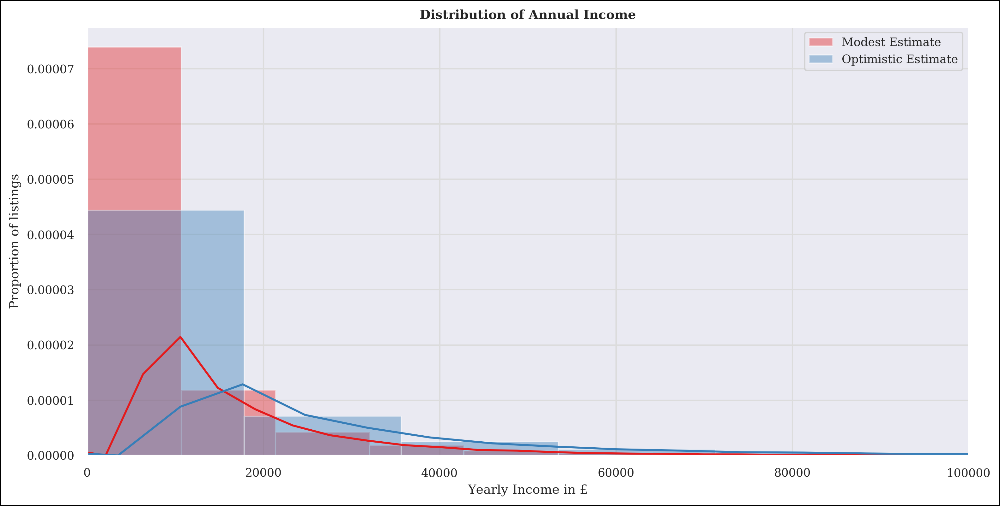

In [83]:
# Here, we will look into estimated average earnings by hosts per listings in each area, and we can visualize and understand short-term rental demands in each neighbourhood. 
# plot distribution of income estimates
plt.figure(figsize=(12, 6), linewidth=1)
sns.distplot(df[~outlier_filter].modest_income, label="Modest Estimate")
sns.distplot(df[~outlier_filter].optimistic_income, label="Optimistic Estimate")
plt.xlim((0,100000))
# label axis
plt.title('Distribution of Annual Income', fontweight='bold')
plt.xlabel('Yearly Income in £')
plt.ylabel('Proportion of listings')
_ = plt.legend()

In [84]:
df[~outlier_filter].modest_income.describe()

count     84417.000000
mean       6984.896522
std       13136.042487
min           0.000000
25%          52.531200
50%        2349.312000
75%        8809.920000
max      534432.000000
Name: modest_income, dtype: float64

**Comment**

The distribution of income is normal distribution and positively skewed. On average most Airbnb hosts earn around £7546. The highest peak of income is around £10,068,
followed by £2,517 and £4,195. However, the upper quantiles start from £8,809 and ends at £534,432, which is a surprising income for a home-share service. Are these hosts operating as a commercial hotel service and not paying the required tax?

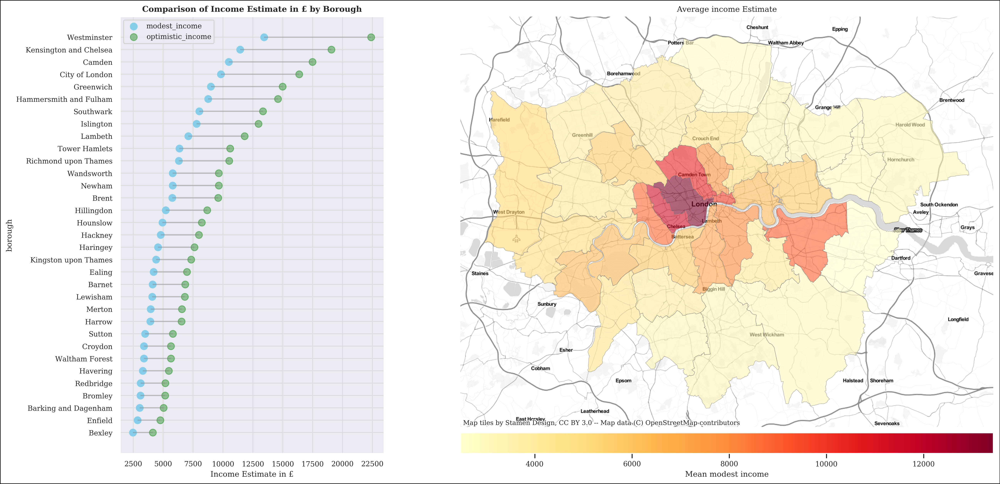

In [85]:
fig, ax = plt.subplots(figsize=(20, 10), linewidth=1)

# plot average income estimate by Boroughs
ax1 = plt.subplot2grid((2, 3), (0, 0), rowspan=2, fig=fig)
plot_lollipop('modest_income', 'optimistic_income', 'borough', 
              'Income Estimate in £', df, ax=ax1, show=False)

# group by neighbourhood then take the median income
g4 = df.groupby(['borough'])['modest_income'].mean().reset_index()
# add geometry attribute 
g4_map = geo_df.merge(g4, on='borough').sort_values(ascending=False, by='modest_income')
# plot choropleth map to show availability
ax2 = plt.subplot2grid((2, 3), (0, 1), rowspan=2, colspan=2, fig=fig)
_ = plot_choropleth_map(
    g4_map, 'modest_income', 'Average income Estimate', 
    basemap=True, ax=ax2, legend_label="Mean modest income"
)

**Comment**

When it comes to earnings, Westminster and Chelsea are at the top which is understandable as these areas are where the upper-class income earners live. Interestingly, It appears to be that Hillingdon benefits from rather low room rates, which lead to a high occupancy - as seen above.

### What does the differences between super hosts and standard hosts look like?

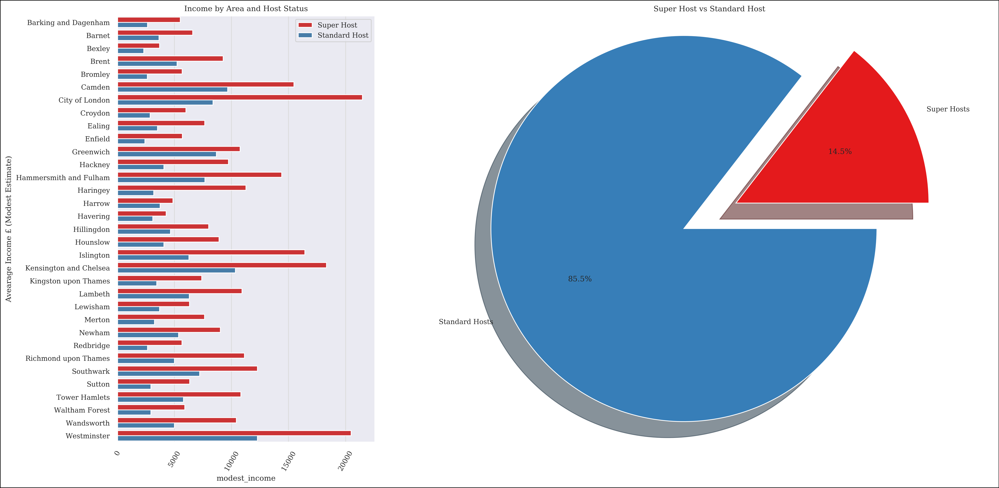

In [86]:
# Using visualization, we analysis the difference between super hosts and standard hosts in terms of proportion of listings and income.
# group by neighbourhood and by status, then take the median income
g5 = df.groupby(['borough', 'host_is_superhost'])['modest_income'].mean().sort_values(ascending=False).reset_index()

fig, ax = plt.subplots(figsize=(20, 10), linewidth=1)
# plot average income estimate by Boroughs
ax1 = plt.subplot2grid((2, 3), (0, 0), rowspan=2, fig=fig)
fig5 = sns.barplot(y='borough', x='modest_income', hue='host_is_superhost', 
            data=g5, hue_order=['t', 'f'])
fig5.set_title("Income by Area and Host Status")
fig5.set(ylabel="Avearage Income £ (Modest Estimate)")
handles, _ = fig5.get_legend_handles_labels()
fig5.legend((handles), ("Super Host", "Standard Host"))
_ = plt.xticks(rotation=60)

# create subset data for pie chart
super_host    = df.host_is_superhost.value_counts()['t']
standard_host = df.host_is_superhost.value_counts()['f']
names = ['Super Hosts','Standard Hosts']
size  = [super_host, standard_host]
# create a pie chart
ax2 = plt.subplot2grid((2, 3), (0, 1), rowspan=2, colspan=2, fig=fig)
ax2.pie(size, labels=names, autopct='%.1f%%', shadow=True, explode=[0.2, 0.1])
ax2.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
ax2.set_title("Super Host vs Standard Host")
plt.show()

**Comment**

There is a significant difference in the super and standard hosts, and we can clearly state that about 14% of hosts earn over £10,000 annually. Can the earning from super hosts put them in the same category as Hotels?

### Demand by Capacity

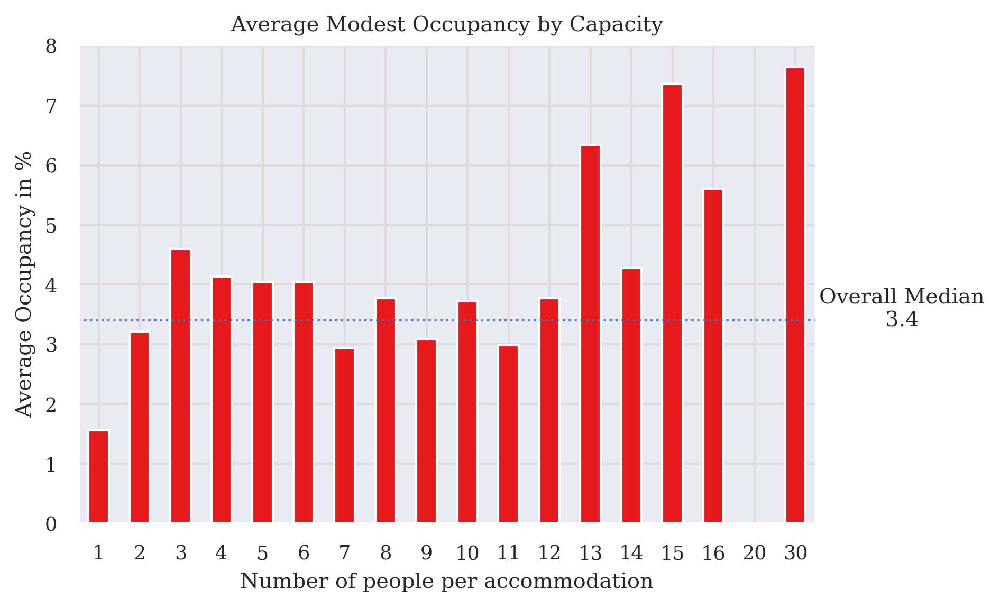

In [87]:
# group by accomodates and plot median occupancy
g6 = df.groupby(['accommodates'])['modest_occupancy'].median()
overral_median = df.modest_occupancy.median()
# make a bar plot
g6.plot(kind='bar', figsize=(6,4))

# label the plot
plt.xlabel('Number of people per accommodation')
plt.xticks(rotation='horizontal')
plt.ylabel('Average Occupancy in %')
plt.title('Average Modest Occupancy by Capacity')

# draw and label the median value
plt.axhline(y=overral_median, xmin=0, xmax=1, linewidth=1, linestyle=':', color='b')
plt.text(x=19.6, y=overral_median - 0.1, s=f'Overall Median\n{overral_median}', ha='center');

**Comment**

Generally, bigger homes seem to be sold more often than smaller ones.

### Popularity of Neighbourhood

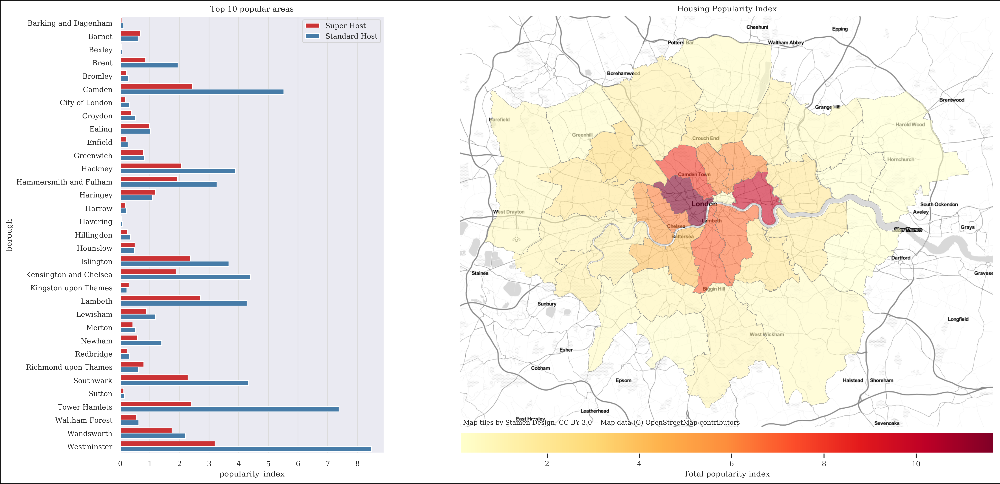

In [88]:
# group by neighbourhood popularity index
# we'll use total number of reviews to visualize the popularity of each neighbourhood by grouping the dataset first by borough.
g7 = df.groupby(['borough', 'host_is_superhost']).agg({'popularity_index': 'sum'}).sort_values(by='popularity_index', ascending=False).reset_index()
g8 = df.groupby(['borough']).agg({'popularity_index': 'sum'}).sort_values(by='popularity_index', ascending=False).reset_index()
# add geometry attribute 
g7_map = geo_df.merge(g8, on='borough').sort_values(ascending=False, by='popularity_index')

fig, ax = plt.subplots(figsize=(20, 10), linewidth=1)

# plot average income estimate by Boroughs
ax1 = plt.subplot2grid((2, 3), (0, 0), rowspan=2, fig=fig)
fig7 = sns.barplot(x='popularity_index', y='borough', hue='host_is_superhost', data=g7, 
            hue_order=['t', 'f'], ax=ax1)
handles, _ = fig7.get_legend_handles_labels()
fig7.legend((handles), ("Super Host", "Standard Host"))
_ = ax1.set_title("Top 10 popular areas")


# plot choropleth map to show popularity index
ax2 = plt.subplot2grid((2, 3), (0, 1), rowspan=2, colspan=2, fig=fig)
_ = plot_choropleth_map(
    g7_map, 'popularity_index', 'Housing Popularity Index', 
    basemap=True, ax=ax2, legend_label="Total popularity index"
)

**Comment**

From the above map, the most popular areas are Westminster, Tower Hamlets, Camden, Lambeth and Chelsea.

## What factors influence occupancy rate?

### Direct influence by host

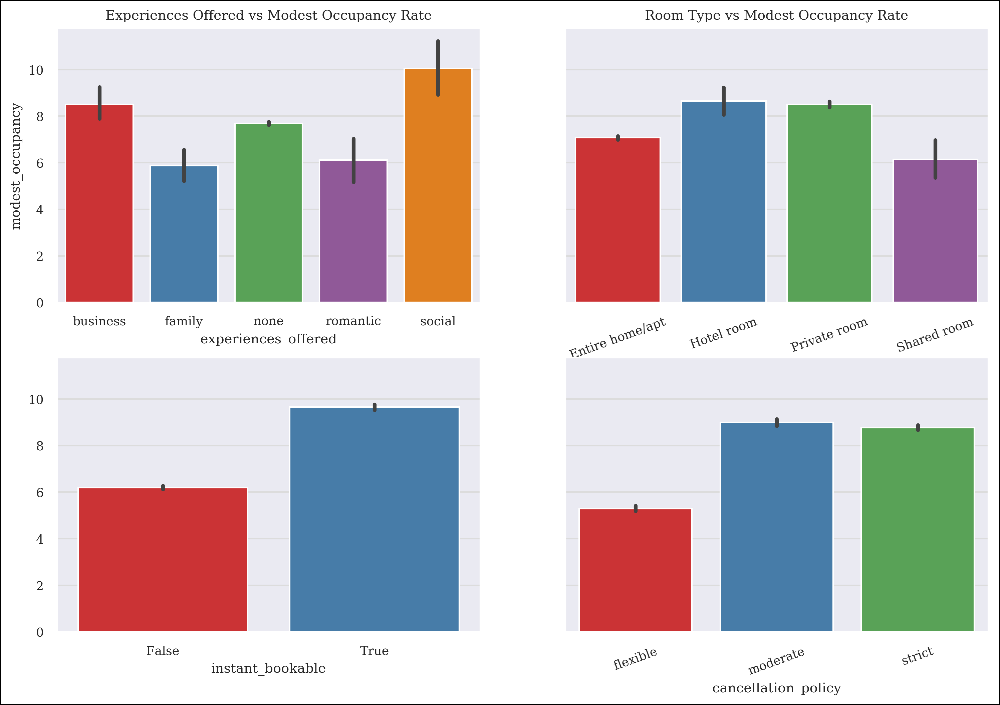

In [89]:
fig, axes = plt.subplots(2, 2, figsize=(12, 8), sharey=True, linewidth=1)
(ax1, ax2), (ax3, ax4) = axes
# plot experiences_offered vs modest_occupancy
sns.barplot(y='modest_occupancy', x='experiences_offered', data=df, ax=ax1)
ax1.set_title("Experiences Offered vs Modest Occupancy Rate")

names = ['False','True']
# plot host_is_superhost vs modest_occupancy
sns.barplot(y='modest_occupancy', x='room_type', data=df, ax=ax2)
ax2.set_title("Room Type vs Modest Occupancy Rate")
plt.sca(ax2)
_ = plt.xticks(rotation=20)

_ = plt.ylabel('')
# plot instant_bookable vs modest_occupancy
sns.barplot(y='modest_occupancy', x='instant_bookable', data=df, ax=ax3)
ax3.set_xticklabels(names)
plt.sca(ax3)

# plot cancellation_policy vs modest_occupancy
fig13 = sns.barplot(y='modest_occupancy', x='cancellation_policy', data=df, ax=ax4)
plt.ylabel('')
plt.sca(ax4)
plt.ylabel('')
_= plt.xticks(rotation=20)

**Comment:**

Many guests are booking accommodation on the run. Turning 'on' Instant Book will make their booking process quick and easy. By allowing Instant Book, the host's chances of achieving super host status are increased, leading to a higher occupancy rate.

### Platform activity and neighbourhood infleunce

In [90]:
# Correlation Matrix Heatmap
numeric_features = [
    'popularity_index', 'availability_365', 'bathrooms', 'calculated_host_listings_count',
    'bedrooms', 'minimum_nights', 'accommodates', 'cleaning_fee',
    'amenities_count', 'summary_count', 'space_count', 'description_count', 
    'price', 'optimistic_occupancy', 'modest_income', 'optimistic_income', 'modest_occupancy'
]
# standardize numerical attribute using zscore
corr_df = df[numeric_features]
scaled_values = StandardScaler().fit_transform(corr_df)
corr_df.loc[:,numeric_features] = scaled_values

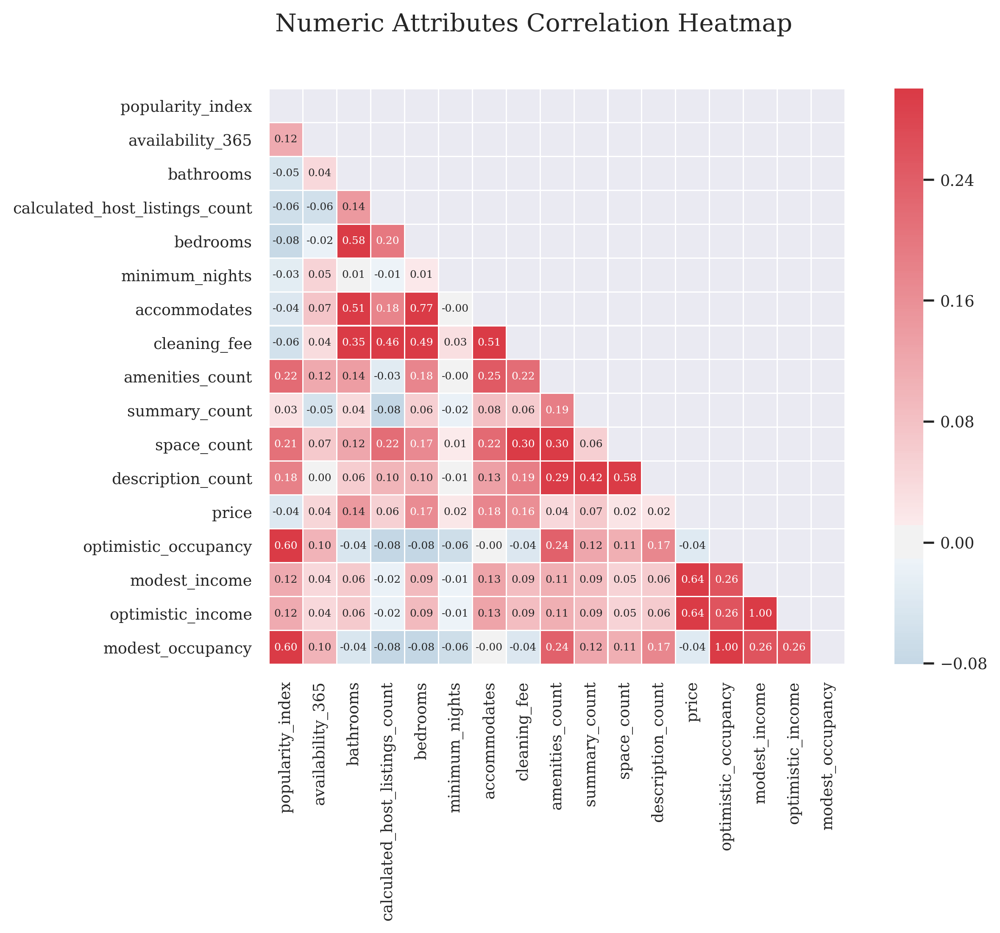

In [91]:
fig, ax = plt.subplots(figsize=(10, 6))
# first normalize values and calculate correlation using pearson correlation.
corr = corr_df.corr()

# generate a mask for the upper triangle
mask = np.zeros_like(corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True

# generate a custom diverging colormap
cmap = sns.diverging_palette(240, 10, as_cmap=True)

# draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, fmt='.2f', annot=True, 
            annot_kws={"size": 6}, ax=ax,
           )
t = fig.suptitle('Numeric Attributes Correlation Heatmap', fontsize=14)

**Comment:**

The gradients in the heatmap above vary based on the strength of the correlation, and can effortlessly spot potential attributes having strong correlations amongst themselves. 
For occupancy rate, we can see Popularity Index have a strong correlation of **0.60**

<Figure size 4500x1800 with 0 Axes>

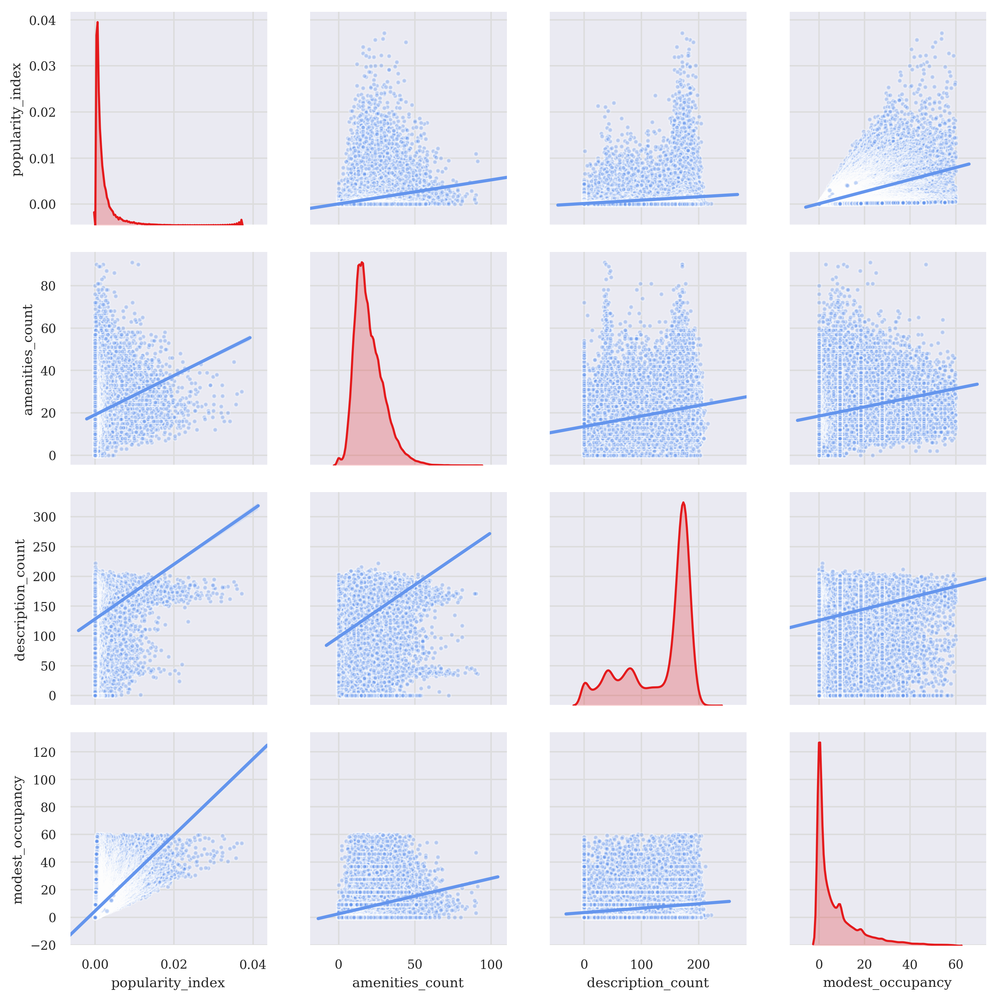

In [92]:
# Lets visualize population_index, and amenties to understand the relationship better
plt.figure(figsize=(15, 6), linewidth=1)

sns.pairplot(
    df, vars=['popularity_index', 'amenities_count', 'description_count', 'modest_occupancy'],
    kind='reg', diag_kind='kde',
    plot_kws=dict(
        color='cornflowerblue',
        scatter_kws=dict(s=10,  alpha=.4, edgecolor='w')
    ),
)

**Comment:**

The above plot shows a significant relationship between popularity index and number of amenities provided. Also length description shows a weak correlation.

## Identifying the factors that contributes to Prices 

The goal here is to determine how much target variance is explained by each of the regressors chosen.

### Linear Regression

In [123]:
## define regressors
cat_columns = ['experiences_offered', 'host_is_superhost', 'room_type', 'instant_bookable','cancellation_policy', 'bed_type']
regressors = cat_columns + [
    'minimum_nights', 'availability_365', 'cleaning_fee', 'accommodates', 'bedrooms', 'bathrooms',
    'amenities_count', 'summary_count', 'space_count', 'description_count', 'distance_to_center',
    'popularity_index', 'calculated_host_listings_count', 'modest_occupancy', 'beds'
]
# define targe variable
target = ['price']

# define regression data
# we'll remove all outliers from the dataset to improve the performance of the model.
reg_df = df[~outlier_filter].loc[:, regressors+target]

# normalize dataset using zscore
reg_df.iloc[:, 6:] = StandardScaler().fit_transform(reg_df.iloc[:, 6:])
# using Multiple Linear Regression with the following formula
# Y = C + M1 * X1 + M2 * X2 + ...Mn *Xn
# Where:
# Y = Dependent variable (output/outcome/prediction/estimation)
# C = Constant (Y-Intercept)
# M = Slope of the regression line (the effect that X has on Y)
# X = Independent variable (input variable used in the prediction of Y)

formula = f'{target[0]} ~ {" + ".join(regressors)}'
print(f"Regression formula: \n{formula}")

Regression formula: 
price ~ experiences_offered + host_is_superhost + room_type + instant_bookable + cancellation_policy + bed_type + minimum_nights + availability_365 + cleaning_fee + accommodates + bedrooms + bathrooms + amenities_count + summary_count + space_count + description_count + distance_to_center + popularity_index + calculated_host_listings_count + modest_occupancy + beds


In [124]:
## Fit the model
model = sm.formula.ols(formula=formula, data=reg_df, hasconst=False).fit()
# display summary 
print(model.summary())

                                 OLS Regression Results                                
Dep. Variable:                  price   R-squared (uncentered):                   0.421
Model:                            OLS   Adj. R-squared (uncentered):              0.421
Method:                 Least Squares   F-statistic:                              1979.
Date:                Sat, 14 Dec 2019   Prob (F-statistic):                        0.00
Time:                        15:47:32   Log-Likelihood:                         -96720.
No. Observations:               84417   AIC:                                  1.935e+05
Df Residuals:                   84386   BIC:                                  1.938e+05
Df Model:                          31                                                  
Covariance Type:            nonrobust                                                  
                                      coef    std err          t      P>|t|      [0.025      0.975]
--------------------

In [125]:
# lets output the standard measures from the model to check the performance
print("R-squared:",model.rsquared)
print("MSE model:",model.mse_model)
print("MSE residuals:",model.mse_resid)
print("MSE total:",model.mse_total)

# test of normality of the residuals:
name = ['Jarque-Bera', 'Chi^2 two-tail prob.', 'Skew', 'Kurtosis']
jarque_test, _, _, _ = sms.jarque_bera(model.resid)
print(f'\nThe Jarque-Bera test of normality is {jarque_test}')

# Test linearity using Rainbow test
name = ['f-statistic', 'p-value']
f_statistic, p_value = sms.linear_rainbow(model)
print(f'\nThe Rainbow test of linearity has a statistic of {f_statistic} and a p-value of {p_value}.')

R-squared: 0.4209711689745592
MSE model: 1146.3588119782376
MSE residuals: 0.5792415427757523
MSE total: 1.0

The Jarque-Bera test of normality is 6081525.179461035

The Rainbow test of linearity has a statistic of 1.144481437772941 and a p-value of 5.935633196861069e-44.


In [126]:
def get_coef_table(lin_reg):
    ''' lin_reg is a fitted statsmodels regression model
    Return a dataframe containing coefficients, pvalues, and the confidence intervals
    https://gist.github.com/zhiyzuo/972b8b95e115c44d6805c929b7b4e2ca
    '''
    err_series = lin_reg.params - lin_reg.conf_int()[0]
    coef_df = pd.DataFrame({
        'varname': err_series.index.values[1:],
        'coef': lin_reg.params.values[1:],
        'ci_err': err_series.values[1:],
        'pvalue': lin_reg.pvalues.round(4).values[1:],                        
    })
    return coef_df

coef_df = get_coef_table(model)

x = coef_df.loc[:, ['coef']]
coef_df['colors'] = ['red' if x < 0 else 'green' for x in coef_df['coef']]
coef_df.sort_values('coef', inplace=True)
coef_df.reset_index(inplace=True)

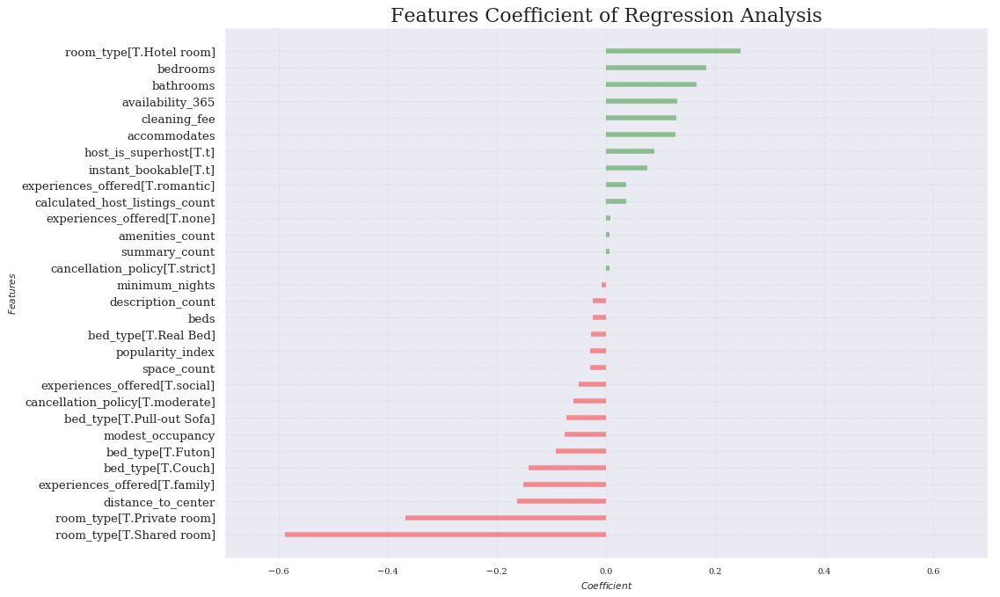

In [127]:
# Visualize coefficient
plt.figure(figsize=(14,10), dpi= 80)
plt.hlines(y=coef_df.index, xmin=0, xmax=coef_df.coef, color=coef_df.colors, alpha=0.4, linewidth=5)
plt.xlim(-0.7, 0.7)

# labels
plt.gca().set(ylabel='$Features$', xlabel='$Coefficient$')
plt.yticks(coef_df.index, coef_df.varname, fontsize=12)
plt.title('Features Coefficient of Regression Analysis', fontdict={'size':20})
plt.grid(linestyle='--', alpha=0.5)
plt.show()

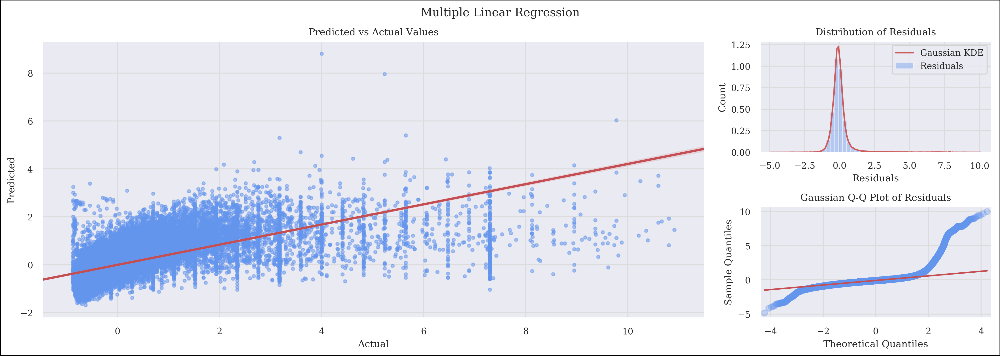

In [128]:
# let's visualize regression results
plt.figure(figsize=(14,5), linewidth=1)

# make predictions
preds = model.predict(reg_df)
# Plot Actual vs Predicted scatterplot
plt.subplot2grid((2,7), (0,0), rowspan=2, colspan=5)
sns.regplot(reg_df.price, preds,  color='cornflowerblue', 
            scatter_kws=dict(alpha=.5, s=10), line_kws=dict(color='r'))
plt.xlabel('Actual'), 
plt.ylabel('Predicted')
plt.title('Predicted vs Actual Values')

## Plot Distribution of Residuals
plt.subplot2grid((2,7), (0,5), rowspan=1, colspan=2)
sns.distplot(reg_df.price-preds,
             hist_kws={'color':'cornflowerblue', 'label':'Residuals'}, 
             kde_kws={'color':'indianred', 'label':'Gaussian KDE'})
plt.xlabel('Residuals'), plt.ylabel('Count')
plt.title('Distribution of Residuals')
plt.legend()

## Plot Q-Q Plot
ax = plt.subplot2grid((2,7), (1,5), rowspan=1, colspan=2)
sm.qqplot(reg_df.price-preds, ax=ax, line='q', color='cornflowerblue', alpha=.3)
plt.title('Gaussian Q-Q Plot of Residuals')

plt.suptitle('Multiple Linear Regression')
plt.tight_layout(rect=[0,0,1,.95])

**Interpreting the Output:**

We can see here that this model has a lower R-squared value — **0.421**, meaning that this model explains **42.1%** of the variance in our dependent variable. We might consider using a method of polynomial regression, but that could lead to a more complex model to interpret.

We can see that both room type and the number of bedrooms are statistically significant in the prediction (or estimation) of rent prices since their p-value is less than 0.05; it is not shocking. We see that an increase in the number of bedrooms by 1 or if the room type is Hotel, the price will rise by **0.1771** and **0.2431** respectively. On the other hand, the price decreases by **-0.6151** if it's a shared room. For travellers, a shared room is not very convenient, and unfortunately, we can expect it to lower home prices. With this same rationale, generally, the house's higher capacity will significantly increase the price. 

The conditional number has a low value of **53**. It informs us that our regression does not have a problem of collinearity. The feature engineering and processing ensured this we carried out.

The Prob (Omnibus) performs a statistical test to evaluate the normality of the residuals. Since the value is 0, the residuals are not normally distributed. This can also be inferred from the Q-Q Plot showing a deviation from the reference line at the extremes. Finally, a Jarque-Bera Normality has also been performed and confirms as well that the residuals are not normally distributed which was expected.

In terms of predictions, the Predicted vs Actual plot depicts the fact that the model tends to heavily underestimate the high values of prices. From the Rainbow test, the null hypothesis is rejected which is telling us that the relationship between independent and target variables is probably not linear.
